## Problem Definition

1. By conducting Sentiment analysis (positive, negative or neutral ) of texts, we can analyse and evaluate amazon foods reputation, strengths and weaknesses of food business and customer needs for food business. 

Questions: Which words/phrases have the most impact on review scores?


Techniques that can be used for sentiment analysis
- Text blob
- SentiWordNet
- Afinn

2. By using K-mean clustering, we can cluster a plenty of reviews into certain few types of categories or themes and find mutual main issues or problems in amazon food buisnesses. 

Questions: What is the impact of Amazon food business topics on review scores?


Techniques that can be used for k-mean clustering
- from sklearn.cluster import KMeans
- from sklearn.metrics.pairwise import cosine_similarity 

3. Data mining

Questions: 
What is the lexical field for good reviews?, 
What are the main issues that frequently emerge in food business?

Techniques that can be sued for data mining
- TF-IDF
- Word cloud (Visualization)
- N-grams Frequencies



In [3]:
pip install textatistic

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.5/40.5 kB 2.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for textatistic: filename=textatistic-0.0.1-py3-none-any.whl size=29051 sha256=05297069a8e0573eeb63ff3fef8bb76afdf7e90bcffcabb3ce0b2546f8a1d265
  Stored in directory: /root/.cache/pip/wheels/6e/31/c3/df8af4aa9ec3f671b0e8bc3bfa642c75918f2479ca4050f5f4
  Created wheel for pyhyphen: filename=PyHyphen-4.0.3-cp37-abi3-linux_x86_64.whl size=67057 sha256=bfd03b3f600aa716dca7bdcb057ce57a73d66713dc691d75310024aa6cb44d74
  Stored in directory: /root/.cache/pip/wheels/5e/8e/2c/099292ddfe67d4168785f44109ee79131c652ee5bdd66502b8
Successfully built textatistic pyhyphen


In [4]:
%matplotlib inline 


import pandas as pd
import numpy as np
import glob
import os

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, ENGLISH_STOP_WORDS 
from textblob import TextBlob
from nltk import word_tokenize
from nltk.tokenize import sent_tokenize
from nltk.stem import PorterStemmer, WordNetLemmatizer
import nltk
nltk.download('punkt')
import string


from langdetect import detect_langs
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

from textatistic import Textatistic

import spacy

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.metrics import mean_squared_error, r2_score
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
# After executing the cell above, Drive files will be present in "/content/drive/My Drive". The below command lists the contents in the drive:
!ls "/content/drive/My Drive/Colab Notebooks"

'Copy of ANLP Session 1_NLP_Basics.ipynb의 사본'   Reviews.csv
'Covid death report.ipynb'			   Untitled
 covid_worldwide.csv				   Untitled0.ipynb
'Review (1).ipynb'				  'Untitled (1)'
 Review.ipynb


In [7]:
url = '/content/drive/My Drive/Colab Notebooks/Reviews.csv'
df = pd.read_csv(url)
df

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...
...,...,...,...,...,...,...,...,...,...,...
568449,568450,B001EO7N10,A28KG5XORO54AY,Lettie D. Carter,0,0,5,1299628800,Will not do without,Great for sesame chicken..this is a good if no...
568450,568451,B003S1WTCU,A3I8AFVPEE8KI5,R. Sawyer,0,0,2,1331251200,disappointed,I'm disappointed with the flavor. The chocolat...
568451,568452,B004I613EE,A121AA1GQV751Z,"pksd ""pk_007""",2,2,5,1329782400,Perfect for our maltipoo,"These stars are small, so you can give 10-15 o..."
568452,568453,B004I613EE,A3IBEVCTXKNOH,"Kathy A. Welch ""katwel""",1,1,5,1331596800,Favorite Training and reward treat,These are the BEST treats for training and rew...


In [8]:
df.describe()

,Id,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time
count,568454.000000,568454.000000,568454.00000,568454.000000,5.684540e+05
mean,284227.500000,1.743817,2.22881,4.183199,1.296257e+09
std,164098.679298,7.636513,8.28974,1.310436,4.804331e+07
min,1.000000,0.000000,0.00000,1.000000,9.393408e+08
25%,142114.250000,0.000000,0.00000,4.000000,1.271290e+09
50%,284227.500000,0.000000,1.00000,5.000000,1.311120e+09
75%,426340.750000,2.000000,2.00000,5.000000,1.332720e+09
max,568454.000000,866.000000,923.00000,5.000000,1.351210e+09


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568454 entries, 0 to 568453
Data columns (total 10 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   Id                      568454 non-null  int64 
 1   ProductId               568454 non-null  object
 2   UserId                  568454 non-null  object
 3   ProfileName             568438 non-null  object
 4   HelpfulnessNumerator    568454 non-null  int64 
 5   HelpfulnessDenominator  568454 non-null  int64 
 6   Score                   568454 non-null  int64 
 7   Time                    568454 non-null  int64 
 8   Summary                 568427 non-null  object
 9   Text                    568454 non-null  object
dtypes: int64(5), object(5)
memory usage: 43.4+ MB


In [10]:
df.sample(10)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
117465,117466,B0016B7Z32,AFU4E0FKGUQ7A,W Everett,0,0,1,1327968000,"Weak, wimpy, worthless",This tea is weak at best when compared to othe...
510855,510856,B000PIJI50,A1P2E8DPWA2L2Z,Ironman,0,0,4,1211846400,Great product,The is a very soothing tea that went right to ...
199171,199172,B002FBH0AK,A8NB711TPAGFB,"Thomas Farrell ""irish02144""",4,4,1,1297814400,Doesn't taste good.,"Unfortunately, this soda just doesn't taste go..."
464901,464902,B000LKVIVE,A30ZVA3LORHINW,"Valerie L. Orton ""val""",0,6,1,1209340800,tastes like pepper,The tin is nice but the taste of these has alo...
351120,351121,B003DGQBCO,A3V1A3C9DTLPME,Peter Faden,2,2,5,1312243200,"A good, spicy blend.","I purchased the 4 oz size, and it arrived with..."
483161,483162,B000FGZKV8,A1EZOQ2CR2TNPG,"J. Hynes ""RiddlesKitty""",4,4,2,1325030400,They changed the recipe!,"I bought a box of this tea a few months ago, a..."
237062,237063,B004ZU0RAE,A2DSCTK5JI45QS,"Kym ""Military mama""",0,0,3,1322438400,Love bottles but break often,I love these bottles. The only downside is tha...
313126,313127,B000LKU3K6,A2W3ABLWMJ84NS,Jessica Snyder,2,2,1,1338940800,I wanted so much to like it!,"First, I expected this to be like dry jerky. ..."
110305,110306,B004867T24,A2VNGRQ182NJLE,brian d foy,2,3,2,1322438400,"Portions are too large, price too high",All four ounces of this tuna is stored in a si...
305270,305271,B005PIJQC0,A3AJ21FFTQ33Q4,smartfan,0,0,4,1294876800,Great taste,The taste is great(tropical punch). You have ...


## Relationship between columns

<Axes: >

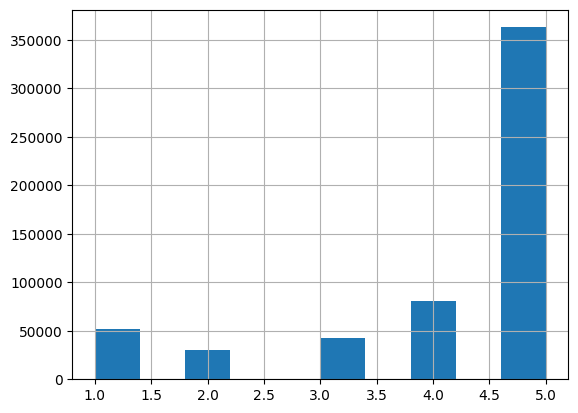

In [11]:
df['Score'].hist()

<ipython-input-12-cb64aa346407>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr());


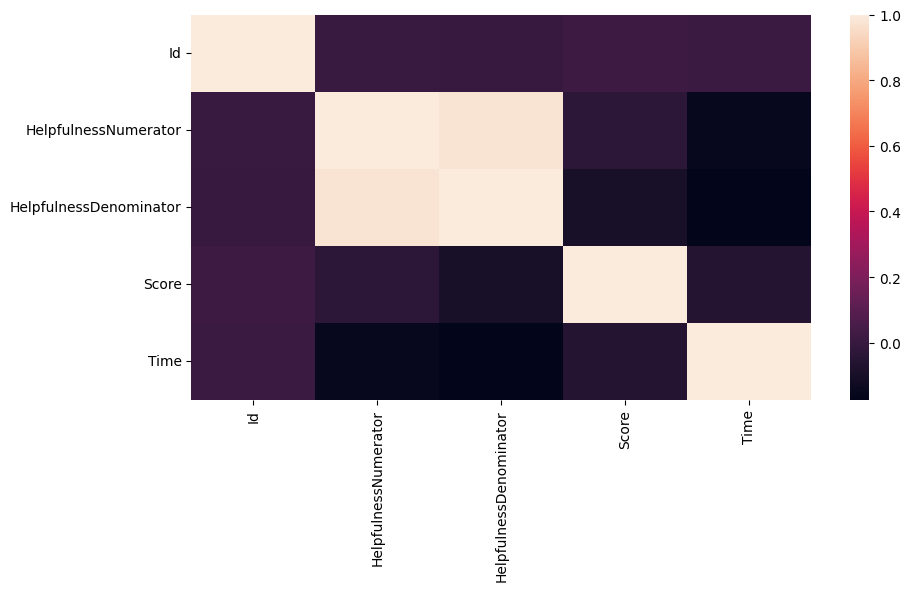

In [12]:
plt.figure(figsize=(10, 5))
sns.heatmap(df.corr());

In [13]:
missing_cols = []

for i in df.columns:
    if df[i].isnull().sum() > 0:
        missing_cols.append(i)
        
missing_cols

['ProfileName', 'Summary']

In [14]:
import plotly.express as px
px.scatter(df, x = 'HelpfulnessNumerator', y = 'HelpfulnessDenominator', 
           color = 'HelpfulnessNumerator', trendline="rolling", trendline_options=dict(window=5),
           title= 'HelpfulnessNumerator')

In [ ]:

px.scatter(df, x = 'HelpfulnessNumerator', y = 'Score', 
           color = 'HelpfulnessNumerator', trendline="rolling", trendline_options=dict(window=5),
           title= 'HelpfulnessNumerator')

In [ ]:

px.scatter(df, x = 'HelpfulnessDenominator', y = 'Score', 
           color = 'HelpfulnessDenominator', trendline="rolling", trendline_options=dict(window=5),
           title= 'HelpfulnessDenominator')

In [ ]:

for column in df.columns:
    fig, axes = plt.subplots(1, 2, figsize = (15, 5))
    sns.histplot(x = df[column], ax = axes[0]).set(title = column)
    sns.boxplot(x  = df[column], ax = axes[1]).set(title = column)
    fig.show()

In [ ]:
df.Text[60]

'Watch your prices with this.  While the assortment was good, and I did get this on a gold box purchase, the price for this was<br />$3-4 less at Target.'

In [ ]:
import re

def clean(text) :
    text = re.sub(r'\S*@\S*\s?', '', text) # Remove email ids
    text = re.sub(r'\s+', ' ', text) # Remove newline (\n)
    text = re.sub(r"\'", "", text) # Remove quotes
    text = re.sub(r"(From:).*(Lines: )\d*?( )", "", text)
    return text


In [ ]:
df["Text"] = df["Text"].apply(clean)
df.Text[60]

'Watch your prices with this. While the assortment was good, and I did get this on a gold box purchase, the price for this was<br />$3-4 less at Target.'

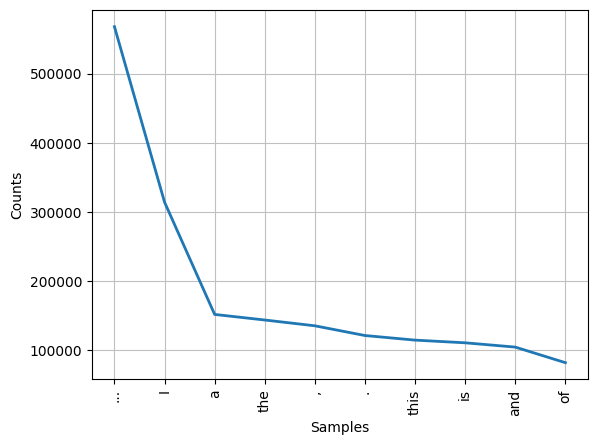

[('...', 568163), ('I', 314342), ('a', 151927), ('the', 143865), (',', 135491), ('.', 121416), ('this', 114764), ('is', 110880), ('and', 104673), ('of', 82148), ('to', 81399), ('This', 70318), ('for', 64601), ('my', 59304), ('have', 57121), ('these', 49776), ('are', 47894), ('was', 45037), ('it', 42670), ('in', 41849)]


In [15]:
# Change 'sentence' column data type from object to string
words = df['Text'].to_string()
tokenized_words = word_tokenize(words)
all_words=nltk.FreqDist(tokenized_words)
all_words.plot(10);
plt.rcParams['figure.figsize'] = (10,10)
print(all_words.most_common(20))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

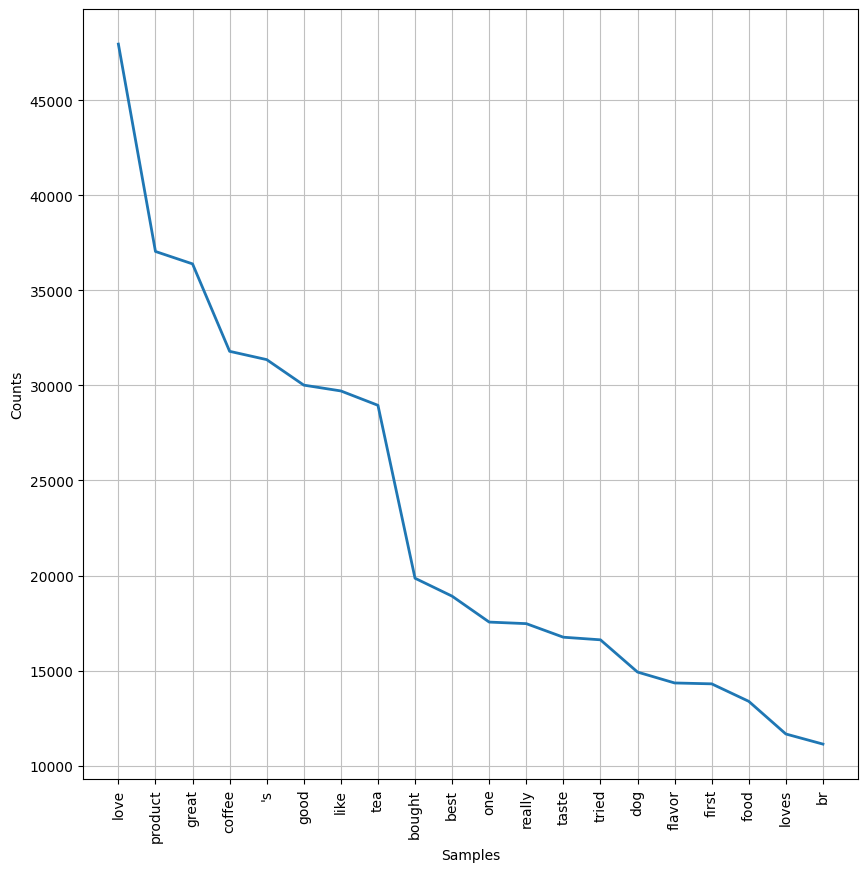

[('love', 47961), ('product', 37050), ('great', 36396), ('coffee', 31796), ("'s", 31359), ('good', 30017), ('like', 29711), ('tea', 28955), ('bought', 19856), ('best', 18912), ('one', 17549), ('really', 17467), ('taste', 16753), ('tried', 16616), ('dog', 14919), ('flavor', 14346), ('first', 14299), ('food', 13379), ('loves', 11661), ('br', 11129)]


In [16]:
text_lower = words.lower()
# Only tokenized words that contain lower case letters, as imporatnt words are more likely to be specific nouns. 
tokenized_words=word_tokenize(text_lower)

import string
from nltk.corpus import stopwords
#stopwords "english" contains many subjective and objective words such as 'i', 'myself' and 'you'.
stop_words=stopwords.words("english")
print(stop_words)
# Adding more unnecessary words into stop_words. 
stop_words.extend(["get","need", "s", "a", "the", "I", "What", "Is", "How", "n't", "Will", "Can", "Does", "Are", "If", "The", "'ve", "'m", "j", "th", "go",])

filtered_tokens = []
for i in tokenized_words:
  if i not in stop_words:
    filtered_tokens.append(i)

# punctuations, which contain '?', '' and '!'
punctuations=list(string.punctuation)
#Add custom punctuations to the list
punctuations.append("...")
punctuations.append("?")

#Create a variable that include all filtered tokenized words. 
filtered_tokens_final=[]
for i in filtered_tokens:
    if i not in punctuations:
        filtered_tokens_final.append(i)

all_words=nltk.FreqDist(filtered_tokens_final)
all_words.plot(20);
print(all_words.most_common(20))

In [17]:
all_words.most_common(10)

[('love', 47961),
 ('product', 37050),
 ('great', 36396),
 ('coffee', 31796),
 ("'s", 31359),
 ('good', 30017),
 ('like', 29711),
 ('tea', 28955),
 ('bought', 19856),
 ('best', 18912)]

In [ ]:
pip install squarify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## K-means clustering

In [19]:
import nltk
nltk.download('punkt')
nltk.download('wordnet')
import string
from nltk import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity 

words = df['Text'].to_string()

#tokenized_words=word_tokenize(text_lower)

# lemmatizing words based on contexts and usage of words in sentences
lemmar = WordNetLemmatizer()
def LemTokens(tokens):
    return [lemmar.lemmatize(token) for token in tokens]


# Removing punctuations, which contain '?', '' and '!'
punctuations= dict((ord(punctuation), None) for punctuation in string.punctuation)


#filtered_tokens_final=[]
#for i in filtered_tokens:
    #if i not in punctuations:
        #filtered_tokens_final.append(i)

def filtered_token_final(text):
  text_lower = text.lower().translate(punctuations) # converting text into lower case and removing punctuations
  tokenized_words=word_tokenize(text_lower) # tokenizing words
  return LemTokens(tokenized_words) # Lemmatizing tokenzied words

tfidf_vectorizer = TfidfVectorizer(stop_words='english' , ngram_range=(1,2), 
                             tokenizer = filtered_token_final, min_df=0.05, max_df=0.85)

# TfidfVectorizer
feature_vect = tfidf_vectorizer.fit_transform(df['Text'])

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'

/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:409: UserWarning:

Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ha', 'le', 'u', 'wa'] not in stop_words.



In [20]:
from sklearn.cluster import KMeans

# will split data into three clusters.
km_cluster = KMeans(n_clusters=3, max_iter=10000, random_state=0)
km_cluster.fit(feature_vect)

# cluster label and centers 
cluster_label = km_cluster.labels_
cluster_centers = km_cluster.cluster_centers_

# Add 'cluster_label' column
df['cluster_label'] = cluster_label
df.sample(5)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label
324563,324564,B000GB0UGC,A3N4CANP6C186O,"D. belcore ""www.fightbackwithyourfork.com""",58,60,4,1245456000,"Culinary teas bulk matcha vs. ""tea ceremony qu...","I am new to matcha drinking, so was somewhat c...",0
83702,83703,B005ZBZLT4,A3S1YBH0YTI7AT,"mrs_belle ""mrs_belle""",2,2,5,1322265600,MY PARENTS LOVE IT!,I purchased this 3 pack for my parents as a pr...,1
321211,321212,B008RWUHA6,ALOI9G09H87IW,Moroni Marten,0,0,4,1320451200,Healthy Snack - But Watch the Calories,I received the Vanilla Blueberry Clusters in a...,2
254959,254960,B000UXFKQG,A1UY4SFP3WIDRS,Carl P Saviola,1,2,4,1293667200,artichokes,"Tender,Right size,great for friends and family...",2
175782,175783,B007XORBV2,A1XYKO38JK6N8K,northkona,2,3,3,1347408000,Label says 6.7 ounces,"The product's OK, but the price is out of line...",2


In [21]:
df[df['cluster_label']==0].sort_values(by='Text')

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label
126462,126463,B004569PAG,A3LHF3RUAS4WLC,Leonid,1,1,5,1329868800,unique and robust,"""...smoothly blends the high notes of a high g...",0
333019,333020,B0000CFXYA,A1S6LV2XO6EN3B,"KuddlKat ""Techie""",1,2,2,1277769600,"""Tins"" means Tins, not envelopes","""6 Tins"" arrived as 1 tin wrapped in paper and...",0
341865,341866,B0017WO2JK,A230CAH5O7B9FQ,Melissa,0,0,2,1340236800,What flavor?,"""A delicate tea with enticing hints of blueber...",0
375986,375987,B0000DBN1I,A281NPSIMI1C2R,"Rebecca of Amazon ""The Rebecca Review""",0,0,5,1074988800,Peaceful Thoughts...,"""A single cup of Tazo Calm has been known to h...",0
540656,540657,B001D0GV90,A33RONBC0EU0A2,Pete Zar,2,3,5,1289433600,For Real Coffee Lovers Only,"""DO NOT BUY THIS ITEM""... UNLESS...... you can...",0
...,...,...,...,...,...,...,...,...,...,...,...
165926,165927,B0009F3SA0,A3ACO0LANLBE1Z,"mac cam ""macmom""",1,1,5,1264809600,love yogi tea,yogi teas are the best tasting tea i have ever...,0
208841,208842,B000E8Y5D6,A6F6Z1T9OZK8M,david olenick,0,12,1,1163808000,o expensive,you can buy lipton for less than 4.00 / 6 oz a...,0
548580,548581,B000LKXRIQ,A1264Q1DKK4BZ7,twiggy2theinfinitepower,1,1,5,1326931200,If you like jasmin green tea...,you will LOVE this tea. It's been a long time ...,0
119998,119999,B000CMF18W,AZ31S5ACWRY15,Tosha,1,1,4,1303516800,If you like black licorice ......,you'll like the way this tea tastes. I don't ...,0


The first cluster is mainly associated with reviews about tea businesses. 

In [22]:
df[df['cluster_label']==1].sort_values(by='Text')

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label
354033,354034,B001A4B8EM,APQ50DQHSNYFR,Ryan Kirk,79,79,1,1283644800,Amazon should be ashamed to even carry this.,"""2% Kopi Luwak"" That's the key part in the de...",1
157070,157071,B002TMV3GC,A2DSXA1E02C86D,Joseph Haschka,0,0,3,1310256000,Where's the romance?,"""A European classic. Sweet caramel and rich va...",1
484179,484180,B0002AHT8E,A3UDAKM6LSHINQ,katyc,0,0,5,1338854400,Greek Coffee,"""Bravo"" Greek Coffee has the perfect color, ar...",1
124338,124339,B005ZBZM52,A2QTB6RFY12WGQ,Tuseline Goldstein,2,2,5,1323648000,Organic never tasted better!,"""By far the best cup of coffee ever!!!"". I rec...",1
440232,440233,B005ZBZLSU,A2QTB6RFY12WGQ,Tuseline Goldstein,1,2,5,1323648000,Looooove It!,"""By far the best cup of coffee ever!!!"". I rec...",1
...,...,...,...,...,...,...,...,...,...,...,...
147551,147552,B001D0IZBM,A2JEQBO69YNGGP,saraht,0,0,5,1350950400,best buy around,you can't beat the price for this coffee. You ...,1
109208,109209,B004AW5THI,A38H6PHZ1A0V26,utahsand,1,1,5,1343347200,awesome supplier,you realy cant beat the deal on coffee they of...,1
453763,453764,B00634YDEQ,A3Q9OI1LGJUW2G,"Jean Porter ""Jean Porter""",0,0,5,1343779200,great,your services were quick and as always the cof...,1
99757,99758,B001ELLAH6,A20CTKKZEQGD3E,"Akua Grant ""Akua Rising""",1,2,1,1262131200,Caffeen Addicts Need Not Apply,zzzzzzz. I had high hopes for this coffee and ...,1


The second cluster may be associated with coffee businesses. 

In [23]:
df[df['cluster_label']==2].sort_values(by='Text')

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label
472747,472748,B000UXH9X8,A1B1Z0MDQ1YACN,Ronald E. Corbin,0,0,1,1345680000,sugar,! think I just ruined my dish. open this and p...,2
366022,366023,B0053TENTW,A3JG5OT0Z5Q1KE,Royal,2,2,1,1325894400,!!! FALSE ADVERTISEMENT !!!,!!! PRODUCT HAS NOTHING TO DO WITH MARVEL!!! F...,2
240425,240426,B001VJ0B0I,A1I6U5AQAT3ZG9,"E. B. MULLIGAN ""Bronwyn""",1,3,3,1342828800,Garlic oil? I thought Garlic was bad for dogs ...,!!!<br />Animal digest? She does that on her o...,2
502792,502793,B000V9ANUW,ALSAOZ1V546VT,"A Research It Maven ""Just the facts please""",1,1,5,1256688000,TWO big candy bars in EACH Package!,"!!HEY, these are BIG! There are actually two c...",2
386401,386402,B002UQBL9Q,A35PQDX1R6IG9E,Lost In The Cosmos,4,5,3,1330905600,There's a reason the description doesn't list ...,""" WITH "" ... Olive Oil. What does this mean...",2
...,...,...,...,...,...,...,...,...,...,...,...
563869,563870,B007JFMH8M,AES9VNGFZLOE1,Alexis McHenry,1,2,5,1342483200,Quaker Soft Baked Oatmeal Cookies,"~ Quick Take: Tasty, chewy, soft-baked cookies...",2
268111,268112,B001E6GFR6,A2FOR1IJSX76LQ,Sly,0,3,5,1282003200,"Yummy. yummy, yummy!!!",~<br /><br />These are soooooooooooooooooooooo...,2
61192,61193,B000FA38ZY,A26UNIPEVYE9DE,Becker,0,0,4,1320192000,PURE CHOCOLATE MALLOMARS COOKIES,~<br />This is a `3 for the price of 1' review...,2
527926,527927,B000VKADRY,A2CEDG8O4AYV8K,Diane A. Shultz,0,0,5,1211846400,Earth's Best Soy Baby Formula,"~Earth's Best Infant Formula Soy Iron, 13.2-Ou...",2


Lastly, third cluster is associated with reviews for foods. 

## Feature Engineering

In [24]:
df['Helpfulness'] = df['HelpfulnessNumerator']/df['HelpfulnessDenominator']

In [25]:
df.dropna(how='any', subset=['Helpfulness'], inplace=True)

In [26]:
df_cluster0 = df[df['cluster_label']==0].reset_index()
df_cluster0 = df_cluster0[(df_cluster0.Helpfulness <=1) & (df_cluster0.Helpfulness >=0.8) & (df_cluster0.HelpfulnessDenominator >=10)]

In [27]:
df_cluster1 = df[df['cluster_label']==1].reset_index()
df_cluster1 = df_cluster1[(df_cluster1.Helpfulness <=1) & (df_cluster1.Helpfulness >=0.8) & (df_cluster1.HelpfulnessDenominator >=10)]

In [28]:
df_cluster2 = df[df['cluster_label']==2].reset_index()
df_cluster2 = df_cluster2[(df_cluster2.Helpfulness <=1) & (df_cluster2.Helpfulness >=0.8) & (df_cluster2.HelpfulnessDenominator >=10)]

In [35]:
combined_cluster = pd.concat([df_cluster0, df_cluster1, df_cluster2], axis=0).drop_duplicates()

In [36]:
combined_cluster

,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness
18,804,805,B004S0AQHA,A1JYQTN8CN3CY2,JC in ABQ,9,10,3,1310428800,Even at $15 seems a little overpriced.,"It looks pretty, but the contents are very min...",0,0.900000
58,2608,2609,B0016FY6H6,A1EA3QWLRO24X8,Raw Cacao Man,15,15,5,1213833600,"Finally, an affordable, delicious green tea po...",I love drinking green tea. It is delicious ho...,0,1.000000
144,5682,5683,B000SATIG4,A3D1XO5JY0NIP9,A. Schmidt,16,17,2,1267920000,Davidson's Darjeeling Tea,This was my first experience of a bad Darjeeli...,0,0.941176
150,5818,5819,B002HFRYZ0,A2U84A32KQTVL2,"M. L. Blair ""Ticket Gal""",11,11,4,1205107200,Premium Oolong Tea,Prince of Tea brand teas are great. The premiu...,0,1.000000
157,6246,6247,B000E65OF6,A3M6RVUVZOQZLB,"Judy K. Polhemus ""Book Collector""",18,19,5,1203033600,a very definite five stars!,"Welcome to heaven, Judy.<br />What?<br />Yes, ...",0,0.947368
...,...,...,...,...,...,...,...,...,...,...,...,...,...
247778,568248,568249,B00374ZKQ0,A2ZIXZP46B737P,D. J. Bradley,19,20,5,1296172800,Great Alternative Sweetener,My review covers the Stevia In The Raw product...,2,0.950000
247779,568249,568250,B00374ZKQ0,A17V9XL4CWTQ6G,Chandler,38,45,1,1320192000,You'll need 3 packs to equal one pack of Truvi...,"First of all, I have no ties with Truvia. In f...",2,0.844444
247780,568250,568251,B00374ZKQ0,A1I1V7QUWSMYGA,Your Online Bookstore,13,15,5,1265760000,This is the only brand out there with minimal ...,I'm not 100% certain this is the same product ...,2,0.866667
247782,568253,568254,B00374ZKQ0,AOJTB8BZVZQPP,Frankie,8,10,5,1282694400,Very good stevia without any extra ingredients.,I bought them at Shoprite (at 3.79 for a box o...,2,0.800000


In [38]:
df = pd.concat([df, combined_cluster], axis=0).drop_duplicates()

In [39]:
df

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness,index
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,2,1.000000,NaN
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,2,1.000000,NaN
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,2,1.000000,NaN
8,9,B000E7L2R4,A1MZYO9TZK0BBI,R. James,1,1,5,1322006400,Yay Barley,Right now I'm mostly just sprouting this so my...,2,1.000000,NaN
10,11,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,I don't know if it's the cactus or the tequila...,2,1.000000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
247778,568249,B00374ZKQ0,A2ZIXZP46B737P,D. J. Bradley,19,20,5,1296172800,Great Alternative Sweetener,My review covers the Stevia In The Raw product...,2,0.950000,568248.0
247779,568250,B00374ZKQ0,A17V9XL4CWTQ6G,Chandler,38,45,1,1320192000,You'll need 3 packs to equal one pack of Truvi...,"First of all, I have no ties with Truvia. In f...",2,0.844444,568249.0
247780,568251,B00374ZKQ0,A1I1V7QUWSMYGA,Your Online Bookstore,13,15,5,1265760000,This is the only brand out there with minimal ...,I'm not 100% certain this is the same product ...,2,0.866667,568250.0
247782,568254,B00374ZKQ0,AOJTB8BZVZQPP,Frankie,8,10,5,1282694400,Very good stevia without any extra ingredients.,I bought them at Shoprite (at 3.79 for a box o...,2,0.800000,568253.0


In [40]:
df['Helpfulness'].isnull().sum()

0

In [41]:
df.sample(10)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness,index
240228,240229,B001VJ0B0I,A24FY1EBJ7EWLH,Cabushka,2,2,4,1342742400,My dogs like it!,My yorkie loves this dog food and gobbles it r...,2,1.000000,NaN
181142,181143,B007Y59HVM,A3MHUDH32RXAM,countrymamabliss,2,4,5,1330992000,Nice Strong Cup of Coffee,I have purchased these k-cup/pods a couple of ...,1,0.500000,NaN
475479,475480,B000EDDS3O,AW8WUR0K0WMWU,RBG,2,3,5,1199664000,Brown rice flour-- the easy way,Ordinarily I like to make flour if I only need...,2,0.666667,NaN
64428,64429,B00016AQJ8,A1YUL9PCJR3JTY,"O. Brown ""Ms. O. Khannah-Brown""",2,2,5,1161216000,"My New Favorite Tea, Marvelous, Delightful","*****<br /><br />Ok, I love lavender, so I'm b...",0,1.000000,NaN
368110,368111,B003B3OOPA,A372XGNN8NBS7J,George,6,6,5,1343779200,Awesome product!,My Mother was diagnosed with Alzheimer's two o...,2,1.000000,NaN
223158,223159,B000HDI5OS,A34C4YSIDWXE8Y,K. O'Hara,1,3,3,1300406400,"Yep, My Order Contained Dented Cans As Well","As always, I received my order quickly via my ...",2,0.333333,NaN
392432,392433,B001DY6TWU,A2LOZMBI3VLS0R,"Shawnie Loo ""Shawnie""",1,1,4,1310515200,good well balanced dry food,I read lots of reviews on the internet on dry ...,2,1.000000,NaN
349787,349788,B000FDN6QW,A1LBI27FX8K52R,Gordon,0,3,3,1301529600,Spanish Bean Soup,Pretty Good but I had to buy a lot of them and...,2,0.000000,NaN
245082,245083,B000GFYRHG,A2V2YJFE9KAN6Q,Coleen E. Sams,1,1,5,1236988800,Like an old friend,I can still remember my first cup of Constant ...,0,1.000000,NaN
45858,45859,B0041NYV8E,A10PEXB6XAQ5XF,Michael Gallagher,0,1,1,1332979200,"Bad Taste During, Horrible Aftertaste That Kee...","Upon opening the package, you get an immediate...",0,0.000000,NaN


<Axes: xlabel='Helpfulness', ylabel='Count'>

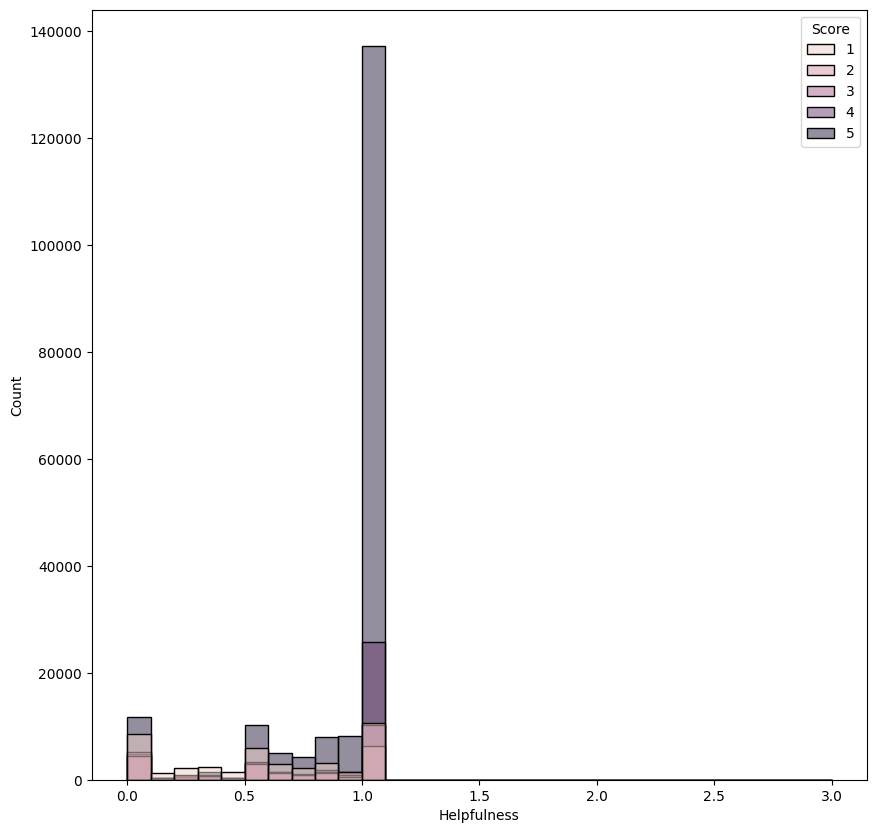

In [42]:
sns.histplot(data = df, x = 'Helpfulness', hue = 'Score', binwidth = 0.1)

In [ ]:
# Creating Word Count numeric column
def word_count(Text):
    wc = len(Text.split())
    return wc

In [ ]:
df['word_count'] = df['Text'].apply(word_count)
df['word_count'].describe()
df['word_count'].head(10)

0      48
2      94
3      41
8      26
10    146
11     64
12     79
13     15
14     22
15     24
Name: word_count, dtype: int64

In [ ]:
df.sample(5)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness,word_count
458101,458102,B000CMF196,A1P90JCEO6TZYA,Mork,1,1,5,1326326400,Flavorful Pick Me Up,I have been drinking this tea with my breakfas...,0,1.000000,101
564037,564038,B001D0IZD0,A17HMM1M7T9PJ1,Timothy B. Riley,82,83,5,1251849600,An extremely flavorful light-roast coffee,One of the pleasures of a Keurig is that you c...,1,0.987952,354
241591,241592,B0081XPTBS,ANNZOX4NXNLL5,songbird123456,6,9,2,1338681600,"One pro, lots of cons...",I have to say that I really wanted this formul...,2,0.666667,356
521258,521259,B000E283KS,A28RS06PBEDWOB,msq,1,1,5,1339459200,Sooo happy to have found them!!,It is almost impossible to find UNfrosted Popt...,2,1.000000,51
285481,285482,B0027YVUOM,A2W7P4NECWXYYX,"Ben El ""Ysrayl""",2,2,4,1272240000,Pizza crackers,(Eating them now) The only reason I even thoug...,2,1.000000,123


In [43]:
# Filter to only data with Helpfulness value not NAN
df_Sample = df[df['Helpfulness'].notnull()][0:10000].reset_index()
df_Sample

,level_0,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness,index
0,0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,2,1.0,NaN
1,2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,2,1.0,NaN
2,3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,2,1.0,NaN
3,8,9,B000E7L2R4,A1MZYO9TZK0BBI,R. James,1,1,5,1322006400,Yay Barley,Right now I'm mostly just sprouting this so my...,2,1.0,NaN
4,10,11,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,I don't know if it's the cactus or the tequila...,2,1.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,19509,19510,B001EO5QO6,A3VL263FW0O1JL,Rivka,1,1,5,1198368000,Fresh and delicious!,Our health care provider recommended eating 1 ...,2,1.0,NaN
9996,19510,19511,B001EO5QO6,A23MGS2U5PPBY1,"Ethann Makinenni ""Ethann""",0,1,4,1173571200,They are great,"I eat these nuts daily, right after I eat some...",2,0.0,NaN
9997,19512,19513,B000E3VANE,A1F7SX3GNVBNE3,"Joshua G. Feldman ""Technophile""",6,6,5,1181001600,This is the best flavor of Zatarain's - univer...,I love all the flavors of Zatarain's. I love ...,2,1.0,NaN
9998,19513,19514,B000E3VANE,A5N60O5P83HSX,A. Newhouse,1,1,5,1311897600,"Great flavor, convenient to buy by the case",These are the same box mixes that I've been bu...,2,1.0,NaN


In [44]:
# Tokenize each item in the Text column
word_tokens = [word_tokenize(review) for review in df_Sample.Text]
sent_tokens = [sent_tokenize(review) for review in df_Sample.Text]
blob = [TextBlob(review) for review in df_Sample.Text]

# Create an empty list to store the length of the Text
len_tokens = []
len_sent = []
Count_Punct = []
polarity = []
subjectivity = []
Readablitys = []

# Iterate over the word_tokens list and determine the length of each item
for i in range(len(word_tokens)):
    len_tokens.append(len(word_tokens[i]))
    len_sent.append(len(sent_tokens[i]))
    polarity.append(blob[i].sentiment[0])
    subjectivity.append(blob[i].sentiment[1])
    
    punctuation_count = 0
    for word in word_tokens[i]:
        if word in string.punctuation:
            punctuation_count += 1
    Count_Punct.append(punctuation_count)
    
    if len(word_tokens[i]) > 10 and len(sent_tokens[i]) >= 2 :
        Readablity = Textatistic(df_Sample['Text'][i]).scores['flesch_score']
    else:
        Readablity = 100
    Readablitys.append(Readablity)

# Create a new feature for the lengh of each review
df_Sample['n_words'] = len_tokens 
df_Sample['n_sents'] = len_sent 
df_Sample['polarity'] = polarity 
df_Sample['subjectivity'] = subjectivity 
df_Sample['n_punct'] = Count_Punct 
df_Sample['Readablity'] = Readablitys 

In [45]:
df_Sample.head(5)

,level_0,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness,index,n_words,n_sents,polarity,subjectivity,n_punct,Readablity
0,0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,2,1.0,NaN,51,3,0.450000,0.433333,3,83.082500
1,2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,2,1.0,NaN,109,8,0.133571,0.448571,15,93.468140
2,3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,2,1.0,NaN,46,3,0.166667,0.533333,5,77.412114
3,8,9,B000E7L2R4,A1MZYO9TZK0BBI,R. James,1,1,5,1322006400,Yay Barley,Right now I'm mostly just sprouting this so my...,2,1.0,NaN,29,3,0.428571,0.545238,2,99.278462
4,10,11,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,I don't know if it's the cactus or the tequila...,2,1.0,NaN,184,4,0.208594,0.682478,29,87.806431


In [46]:
# Load the en_core_web_m model
nlp = spacy.load('en_core_web_sm')
stopwords = spacy.lang.en.stop_words.STOP_WORDS

# Function to preprocess text
def preprocess(text):
        # Create Doc object
    doc = nlp(text, disable=['ner', 'parser'])
    # Generate lemmas
    lemmas = [token.lemma_ for token in doc]
    # Remove stopwords and non-alphabetic characters
    a_lemmas = [lemma for lemma in lemmas 
            if lemma.isalpha() and lemma not in stopwords]
    
    return ' '.join(a_lemmas)

# Apply preprocess to ted['transcript']
df_Sample['Text_Cleaned'] = df_Sample['Text'].apply(preprocess)

In [47]:
def proper_nouns(text, model=nlp):
    # Create doc object
    doc = model(text)
    # Generate list of POS tags
    pos = [token.pos_ for token in doc]
    
    # Return number of proper nouns
    return pos.count('PROPN')

def nouns(text, model=nlp):
    # Create doc object
    doc = model(text)
    # Generate list of POS tags
    pos = [token.pos_ for token in doc]
    
    # Return number of other nouns
    return pos.count('NOUN')

# Apply Count of PRORN AND NOUN columns
df_Sample['n_PROPN'] = df_Sample['Text'].apply(proper_nouns)
df_Sample['n_NOUN'] = df_Sample['Text'].apply(nouns)

In [48]:
pip install bertopic

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.7/120.7 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 44.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 10.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 10.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 76.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 63.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 21.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 72.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   

In [49]:
reviews= df_Sample['Text_Cleaned']
reviews.sample(5)

17      McCann Instant Irish Oatmeal Variety Pack Regu...
5749    believe I buy yard sale cent packaging perfect...
5584    I grow drink Lipton loose leaf tea realize ice...
40      peppermint stick delicious fun eat dad I Chris...
9       daughter love twizzler shipment pound hit spot...
Name: Text_Cleaned, dtype: object

In [50]:
from bertopic import BERTopic
from sklearn.feature_extraction.text import CountVectorizer


vectorizer_model = CountVectorizer(ngram_range=(1, 2), stop_words='english')

model = BERTopic(
    vectorizer_model=vectorizer_model,
    language='english', calculate_probabilities=True,
    verbose=True
)
topics, probs = model.fit_transform(reviews) #create topics

Batches:   0%|          | 0/313 [00:00<?, ?it/s]

2023-05-14 12:56:12,949 - BERTopic - Transformed documents to Embeddings
2023-05-14 12:57:03,929 - BERTopic - Reduced dimensionality
2023-05-14 12:57:14,121 - BERTopic - Clustered reduced embeddings


In [51]:
df_Sample['topics'] = model.topics_

In [52]:
df_Sample.head(5)

,level_0,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,...,n_words,n_sents,polarity,subjectivity,n_punct,Readablity,Text_Cleaned,n_PROPN,n_NOUN,topics
0,0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,...,51,3,0.450000,0.433333,3,83.082500,I buy Vitality dog food product find good qual...,2,8,3
1,2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",...,109,8,0.133571,0.448571,15,93.468140,confection century light pillowy citrus gelati...,12,13,18
2,3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,...,46,3,0.166667,0.533333,5,77.412114,look secret ingredient Robitussin I believe I ...,4,5,5
3,8,9,B000E7L2R4,A1MZYO9TZK0BBI,R. James,1,1,5,1322006400,Yay Barley,...,29,3,0.428571,0.545238,2,99.278462,right I sprout cat eat grass love I rotate Whe...,2,2,64
4,10,11,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,...,184,4,0.208594,0.682478,29,87.806431,I know cactus tequila unique combination ingre...,5,23,16


In [53]:
# Create sparse matrix from the vectorizer
vect = TfidfVectorizer(stop_words='english', ngram_range=(1, 2), max_features=200, token_pattern=r'\b[^\d\W][^\d\W]+\b').fit(df_Sample.Text_Cleaned)

X = vect.transform(df_Sample.Text_Cleaned)
# Create a DataFrame
reviews_transformed = pd.DataFrame(X.toarray())
print('Top 5 rows of the DataFrame: \n', reviews_transformed.head())

Top 5 rows of the DataFrame: 
    0    1    2    3        4    5    6    7    8    9    ...  190       191  \
0  0.0  0.0  0.0  0.0  0.00000  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.000000   
1  0.0  0.0  0.0  0.0  0.00000  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.000000   
2  0.0  0.0  0.0  0.0  0.00000  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.000000   
3  0.0  0.0  0.0  0.0  0.00000  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.000000   
4  0.0  0.0  0.0  0.0  0.14067  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.216777   

   192  193  194  195  196  197  198  199  
0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
1  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
3  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
4  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  

[5 rows x 200 columns]


In [54]:
Other_Features = df_Sample[['n_words', 'n_sents', 'polarity', 'subjectivity','n_punct', 'Readablity', 'n_PROPN', 'n_NOUN', 'cluster_label', 'topics']]
# Combine the vectorizer with other feature columns:
Features = pd.concat([reviews_transformed, Other_Features], axis=1)
Features

,0,1,2,3,4,5,6,7,8,9,...,n_words,n_sents,polarity,subjectivity,n_punct,Readablity,n_PROPN,n_NOUN,cluster_label,topics
0,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,51,3,0.450000,0.433333,3,83.082500,2,8,2,3
1,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,109,8,0.133571,0.448571,15,93.468140,12,13,2,18
2,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,46,3,0.166667,0.533333,5,77.412114,4,5,2,5
3,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,29,3,0.428571,0.545238,2,99.278462,2,2,2,64
4,0.000000,0.000000,0.000000,0.0,0.14067,0.0,0.000000,0.0,0.000000,0.000000,...,184,4,0.208594,0.682478,29,87.806431,5,23,2,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.239314,0.0,0.000000,0.000000,...,69,4,0.071581,0.411467,4,86.218173,0,14,2,-1
9996,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,28,2,0.571429,0.633929,4,88.905000,0,1,2,-1
9997,0.118794,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.134205,0.114171,...,287,19,0.158333,0.390946,36,89.644084,9,47,2,-1
9998,0.000000,0.155029,0.146508,0.0,0.00000,0.0,0.000000,0.0,0.219329,0.000000,...,146,5,0.143348,0.412798,23,82.019130,6,20,2,-1


In [55]:
y = y = df_Sample.Helpfulness
x_features = df_Sample[['n_words', 'n_sents', 'polarity', 'subjectivity','n_punct', 'Readablity', 'n_PROPN', 'n_NOUN', 'cluster_label', 'topics']]
X = x_features

In [56]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler

In [57]:
df.groupby(['Helpfulness'])[['Text']].count()

,Text
Helpfulness,
0.000000,33774
0.010989,1
0.021277,1
0.022222,4
0.023256,1
...,...
0.996198,2
0.996894,2
1.000000,190046


In [58]:
X_train, X_test, y_train, y_test =  train_test_split(X, y, test_size=0.2, random_state=426)

In [59]:
multi_scaler = StandardScaler()
multi_scaler_training = multi_scaler.fit_transform(X_train)
multi_scaler_testing = multi_scaler.fit_transform(X_test)


In [60]:
mm_linear_train = LinearRegression(fit_intercept=True)
mm_linear_test = LinearRegression(fit_intercept=True)

In [61]:
mm_linear_train.fit(multi_scaler_training, y_train)

LinearRegression()

In [62]:
mm_linear_preds = mm_linear_train.predict(multi_scaler_testing)

In [63]:
r2_score(y_test, mm_linear_preds)

0.04002089310438317

In [64]:
print(mm_linear_train.score(multi_scaler_testing, mm_linear_preds))

1.0


In [65]:
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

multivariate_mae  = mean_absolute_error(y_test, mm_linear_preds)
multivariate_mse = mean_squared_error(y_test, mm_linear_preds, multioutput = 'uniform_average')
multivariate_rmse = mean_squared_error(y_test, mm_linear_preds, squared=False)

print("MAE:", multivariate_mae)
print("MSE:", multivariate_mse)
print("RMSE:", multivariate_rmse)


MAE: 0.2862332200059954
MSE: 0.11952344021547574
RMSE: 0.3457216224297748


In [66]:
df_pred_multi = pd.DataFrame({'Actual Value (Best Features)'    : y_test,
                              'Predicted Value (Best Features)' : mm_linear_preds,
                              'Difference (Best Features)'      : abs(y_test - mm_linear_preds)})


df_pred_multi

,Actual Value (Best Features),Predicted Value (Best Features),Difference (Best Features)
6052,1.000000,0.735629,0.264371
1396,0.000000,0.632203,0.632203
8752,1.000000,0.688194,0.311806
355,0.833333,0.789873,0.043460
7665,1.000000,0.740574,0.259426
...,...,...,...
9426,1.000000,0.942716,0.057284
5918,1.000000,0.827180,0.172820
4612,1.000000,0.744707,0.255293
8415,1.000000,0.763821,0.236179


In [67]:
import altair as alt

perfect_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': y_test})).mark_line(color='red').encode(
    x='Helpfulness',
    y='preds'
)

pred_chart_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': mm_linear_preds})).mark_line().encode(
    x='Helpfulness',
    y='preds'
  )

pred_chart_test + perfect_test

alt.LayerChart(...)

In [68]:
import statsmodels.api as sm
sm_st_xtrain = sm.add_constant(multi_scaler_training)

In [69]:
lr_feat = sm.OLS(y_train, sm_st_xtrain).fit()

In [70]:
lr_summary = sm.OLS(y_train, sm_st_xtrain).fit()

In [71]:
lr_summary.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            Helpfulness   R-squared:                       0.038
Model:                            OLS   Adj. R-squared:                  0.036
Method:                 Least Squares   F-statistic:                     31.26
Date:                Sun, 14 May 2023   Prob (F-statistic):           5.82e-60
Time:                        12:58:26   Log-Likelihood:                -2883.3
No. Observations:                8000   AIC:                             5789.
Df Residuals:                    7989   BIC:                             5866.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7638      0.004    196.770      0.000       0.756       0.771
x1            -0.0125      0.021     -0.584      0.559      -0.055       0.029
x2             0.0228      0.008      3.006      0.003       0.008       0.038
x3             0.0636      0.004     15.291      0.000       0.055       0.072
x4            -0.0051      0.004     -1.253      0.210      -0.013       0.003
x5            -0.0394      0.012     -3.337      0.001      -0.063      -0.016
x6            -0.0145      0.004     -3.386      0.001      -0.023      -0.006
x7             0.0049      0.006      0.804      0.422      -0.007       0.017
x8             0.0420      0.016      2.682      0.007       0.011       0.073
x9            -0.0061      0.004     -1.514      0.130      -0.014       0.002
x10            0.0158      0.004      3.955      0.000       0.008       0.024
==============================================================================
Omnibus:                     1268.622   Durbin-Watson:                   2.023
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1983.778
Skew:                          -1.217   Prob(JB):                         0.00
Kurtosis:                       3.153   Cond. No.                         13.6
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

KNN Regressor

In [107]:
knn_train = KNeighborsRegressor(n_neighbors=100, metric='manhattan')
knn_test = KNeighborsRegressor(n_neighbors=100, metric='manhattan')

In [108]:
knn_train.fit(multi_scaler_training, y_train)

KNeighborsRegressor(metric='manhattan', n_neighbors=100)

In [109]:
knn_preds = knn_train.predict(multi_scaler_testing)

In [110]:
r2_score(y_test, knn_preds)

0.04071707066490182

In [97]:
print(knn_train.score(multi_scaler_testing, knn_preds))

1.0


In [98]:
knn_mae  = mean_absolute_error(y_test, knn_preds)
knn_mse = mean_squared_error(y_test, knn_preds, multioutput = 'uniform_average')
knn_rmse = mean_squared_error(y_test, knn_preds, squared=False)

print("MAE:", knn_mae)
print("MSE:", knn_mse)
print("RMSE:", knn_rmse)

MAE: 0.28339488448015426
MSE: 0.12024975216208372
RMSE: 0.34677046033663783


In [78]:
df_pred_knn = pd.DataFrame({'Actual Value (Best Features)'    : y_test,
                              'Predicted Value (Best Features)' : knn_preds,
                              'Difference (Best Features)'      : abs(y_test - knn_preds)})


df_pred_knn

,Actual Value (Best Features),Predicted Value (Best Features),Difference (Best Features)
6052,1.000000,0.783569,0.216431
1396,0.000000,0.716298,0.716298
8752,1.000000,0.702653,0.297347
355,0.833333,0.839705,0.006371
7665,1.000000,0.785690,0.214310
...,...,...,...
9426,1.000000,0.780389,0.219611
5918,1.000000,0.837305,0.162695
4612,1.000000,0.784442,0.215558
8415,1.000000,0.770595,0.229405


In [79]:
import altair as alt

perfect_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': y_test})).mark_line(color='red').encode(
    x='Helpfulness',
    y='preds'
)

pred_chart_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': knn_preds})).mark_line().encode(
    x='Helpfulness',
    y='preds'
  )

pred_chart_test + perfect_test

alt.LayerChart(...)

In [80]:
lr_summary.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            Helpfulness   R-squared:                       0.038
Model:                            OLS   Adj. R-squared:                  0.036
Method:                 Least Squares   F-statistic:                     31.26
Date:                Sun, 14 May 2023   Prob (F-statistic):           5.82e-60
Time:                        13:02:40   Log-Likelihood:                -2883.3
No. Observations:                8000   AIC:                             5789.
Df Residuals:                    7989   BIC:                             5866.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7638      0.004    196.770      0.000       0.756       0.771
x1            -0.0125      0.021     -0.584      0.559      -0.055       0.029
x2             0.0228      0.008      3.006      0.003       0.008       0.038
x3             0.0636      0.004     15.291      0.000       0.055       0.072
x4            -0.0051      0.004     -1.253      0.210      -0.013       0.003
x5            -0.0394      0.012     -3.337      0.001      -0.063      -0.016
x6            -0.0145      0.004     -3.386      0.001      -0.023      -0.006
x7             0.0049      0.006      0.804      0.422      -0.007       0.017
x8             0.0420      0.016      2.682      0.007       0.011       0.073
x9            -0.0061      0.004     -1.514      0.130      -0.014       0.002
x10            0.0158      0.004      3.955      0.000       0.008       0.024
==============================================================================
Omnibus:                     1268.622   Durbin-Watson:                   2.023
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1983.778
Skew:                          -1.217   Prob(JB):                         0.00
Kurtosis:                       3.153   Cond. No.                         13.6
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## DecisionTree Regression

In [112]:
from sklearn.tree import DecisionTreeRegressor
tree_train = DecisionTreeRegressor()
tree_test = DecisionTreeRegressor()

In [113]:
tree_train.fit(multi_scaler_training, y_train)

DecisionTreeRegressor()

In [121]:
tree_preds = tree_train.predict(multi_scaler_testing)

In [124]:
r2_score(y_test, tree_preds)

-0.9559852030934746

In [122]:
tree_mae  = mean_absolute_error(y_test, tree_preds)
tree_mse = mean_squared_error(y_test, tree_preds, multioutput = 'uniform_average')
tree_rmse = mean_squared_error(y_test, tree_preds, squared=False)

print("MAE:", tree_mae)
print("MSE:", tree_mse)
print("RMSE:", tree_rmse)

MAE: 0.3248224100736689
MSE: 0.24353246732662356
RMSE: 0.493490088377288


In [125]:
df_pred_knn = pd.DataFrame({'Actual Value (Best Features)'    : y_test,
                              'Predicted Value (Best Features)' : tree_preds,
                              'Difference (Best Features)'      : abs(y_test - tree_preds)})


df_pred_knn

,Actual Value (Best Features),Predicted Value (Best Features),Difference (Best Features)
6052,1.000000,0.750000,0.250000
1396,0.000000,0.000000,0.000000
8752,1.000000,0.666667,0.333333
355,0.833333,0.666667,0.166667
7665,1.000000,1.000000,0.000000
...,...,...,...
9426,1.000000,0.000000,1.000000
5918,1.000000,1.000000,0.000000
4612,1.000000,0.000000,1.000000
8415,1.000000,0.857143,0.142857


In [123]:


perfect_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': y_test})).mark_line(color='red').encode(
    x='Helpfulness',
    y='preds'
)

pred_chart_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': tree_preds})).mark_line().encode(
    x='Helpfulness',
    y='preds'
  )

pred_chart_test + perfect_test

alt.LayerChart(...)